<h1 style="font-weight:600; font-size:36px; color:#1e88e5;">  
    Task 2: NLP Text Classification on Setiment Data
</span>
<span style="font-size:22px; font-weight:600; color:#555;">
</h1>

In [19]:
# Import necessary libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import re
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import classification_report, precision_score, recall_score, f1_score, confusion_matrix ,accuracy_score
from gensim.models import Word2Vec
from sklearn.ensemble import RandomForestClassifier


In [20]:
# Download NLTK data (run once)
import nltk
nltk.download('stopwords')
nltk.download('wordnet')

sns.set_style('whitegrid')
plt.rcParams['figure.figsize'] = (12, 6)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\HP\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\HP\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [21]:
# 1. Load the Dataset

print("Step 1: Loading the sentiment dataset...")
df = pd.read_csv('3) Sentiment dataset.csv')




Step 1: Loading the sentiment dataset...


In [22]:
# See some features of our Data
print("Dataset shape:", df.shape)
print("\nFirst 5 rows:")
print(df.head())

Dataset shape: (732, 15)

First 5 rows:
   Unnamed: 0.1  Unnamed: 0  \
0             0           0   
1             1           1   
2             2           2   
3             3           3   
4             4           4   

                                                Text    Sentiment  \
0   Enjoying a beautiful day at the park!        ...   Positive     
1   Traffic was terrible this morning.           ...   Negative     
2   Just finished an amazing workout! 💪          ...   Positive     
3   Excited about the upcoming weekend getaway!  ...   Positive     
4   Trying out a new recipe for dinner tonight.  ...   Neutral      

             Timestamp            User     Platform  \
0  2023-01-15 12:30:00   User123          Twitter     
1  2023-01-15 08:45:00   CommuterX        Twitter     
2  2023-01-15 15:45:00   FitnessFan      Instagram    
3  2023-01-15 18:20:00   AdventureX       Facebook    
4  2023-01-15 19:55:00   ChefCook        Instagram    

                           

In [23]:
# 2. Data Cleaning & Sentiment Standardization

print("\nStep 2: Cleaning and standardizing sentiments...")

# Keep only essential columns
df = df[['Text', 'Sentiment']].copy()

# Drop missing
df = df.dropna(subset=['Text', 'Sentiment'])

# Standardize sentiment labels (treat 'Happy' as 'Positive')
df['Sentiment'] = df['Sentiment'].str.strip()
df['Sentiment'] = df['Sentiment'].replace({'Happy': 'Positive'})

print("Unique sentiments after standardization:", df['Sentiment'].unique())


Step 2: Cleaning and standardizing sentiments...
Unique sentiments after standardization: ['Positive' 'Negative' 'Neutral' 'Anger' 'Fear' 'Sadness' 'Disgust'
 'Happiness' 'Joy' 'Love' 'Amusement' 'Enjoyment' 'Admiration' 'Affection'
 'Awe' 'Disappointed' 'Surprise' 'Acceptance' 'Adoration' 'Anticipation'
 'Bitter' 'Calmness' 'Confusion' 'Excitement' 'Kind' 'Pride' 'Shame'
 'Elation' 'Euphoria' 'Contentment' 'Serenity' 'Gratitude' 'Hope'
 'Empowerment' 'Compassion' 'Tenderness' 'Arousal' 'Enthusiasm'
 'Fulfillment' 'Reverence' 'Despair' 'Grief' 'Loneliness' 'Jealousy'
 'Resentment' 'Frustration' 'Boredom' 'Anxiety' 'Intimidation'
 'Helplessness' 'Envy' 'Regret' 'Curiosity' 'Indifference' 'Numbness'
 'Melancholy' 'Nostalgia' 'Ambivalence' 'Determination' 'Zest' 'Hopeful'
 'Proud' 'Grateful' 'Empathetic' 'Compassionate' 'Playful' 'Free-spirited'
 'Inspired' 'Confident' 'Bitterness' 'Yearning' 'Fearful' 'Apprehensive'
 'Overwhelmed' 'Jealous' 'Devastated' 'Frustrated' 'Envious' 'Dismissiv

In [24]:
# 3. Text Preprocessing (Tokenization, Stop Words, Lemmatization)
# ========================
print("\nStep 3: Text preprocessing...")

stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()

def clean_and_preprocess(text):
    text = str(text)
    # Remove URLs, mentions, hashtags, special chars
    text = re.sub(r'http\S+', '', text)
    text = re.sub(r'@\w+', '', text)
    text = re.sub(r'#\w+', '', text)
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    text = text.lower().strip()
    
    # Tokenization (split), remove stop words, lemmatize
    words = text.split()
    words = [lemmatizer.lemmatize(word) for word in words if word not in stop_words and len(word) > 2]
    
    return ' '.join(words)

df['processed_text'] = df['Text'].apply(clean_and_preprocess)

# Remove empty texts after preprocessing (smart & safe)
before = len(df)
df = df[df['processed_text'].str.strip() != ''].reset_index(drop=True)
after = len(df)
print(f"Removed {before - after} empty texts after preprocessing")


Step 3: Text preprocessing...
Removed 0 empty texts after preprocessing



Step 4: EDA...


C:\Users\HP\AppData\Local\Temp\ipykernel_7040\2920331968.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x='Sentiment', order=df['Sentiment'].value_counts().index, palette='viridis')


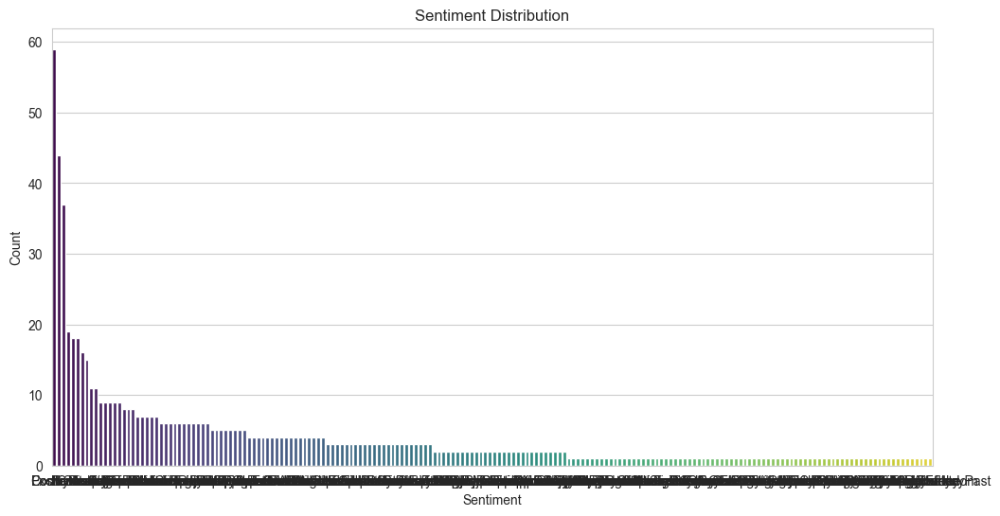

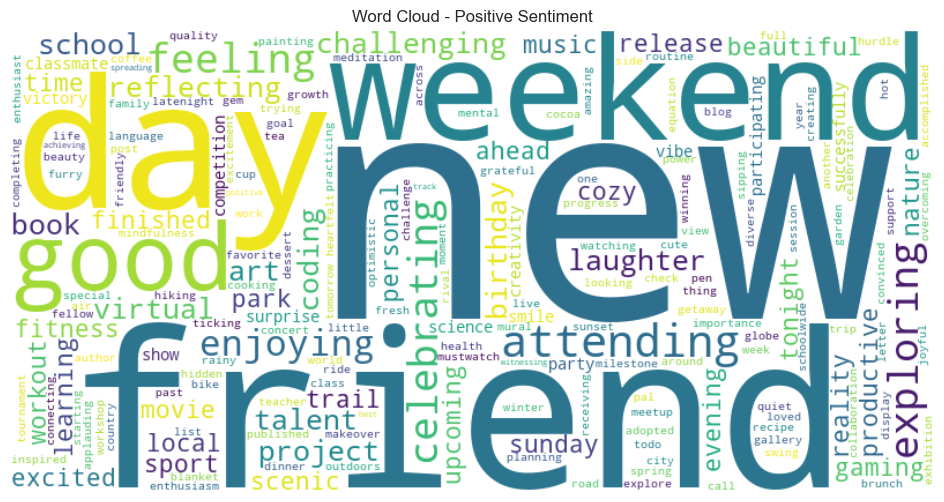

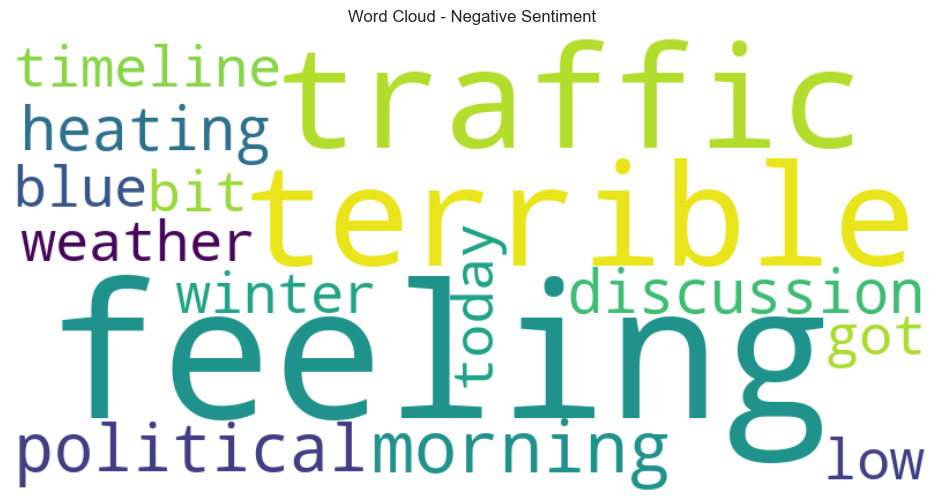

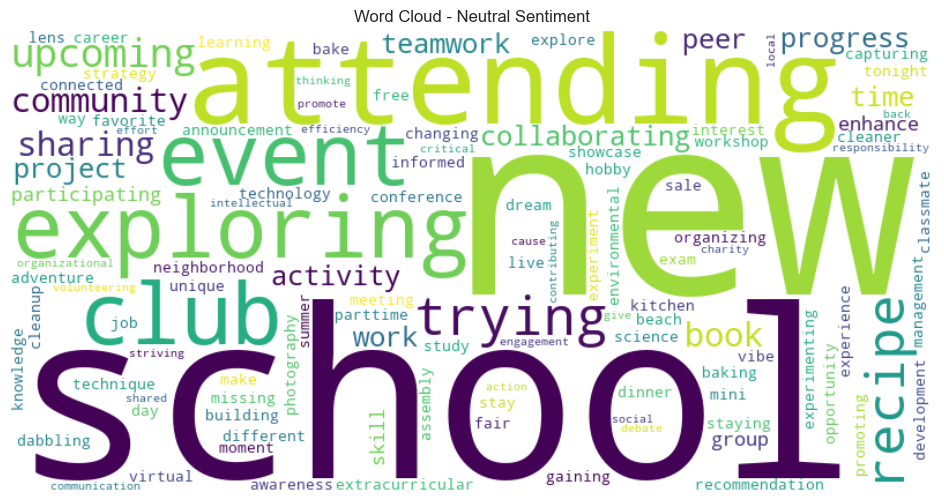

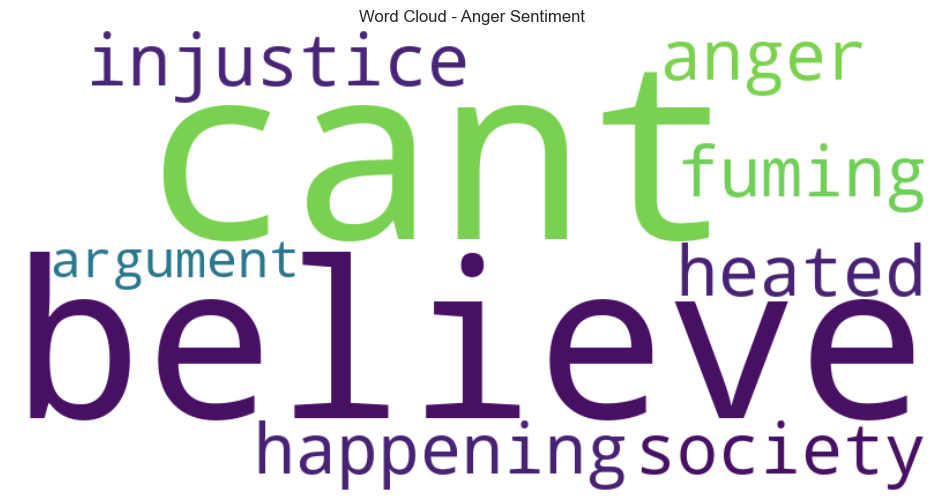

...

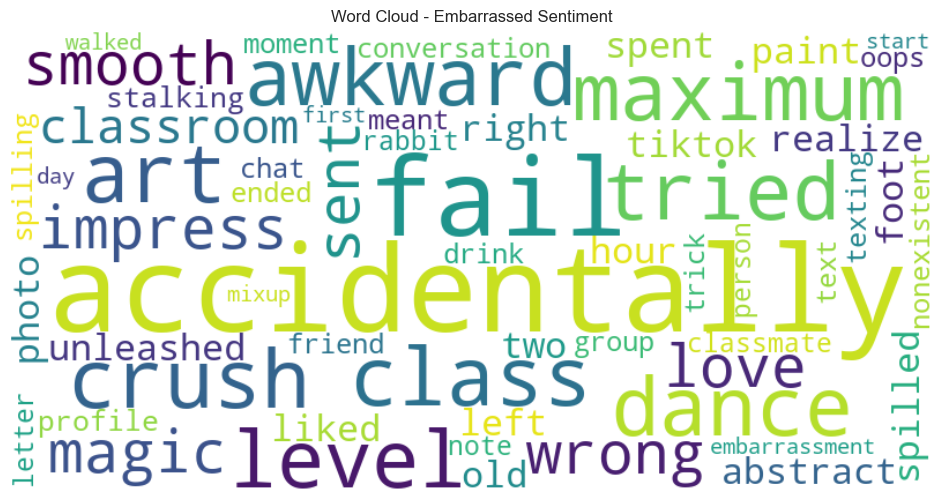

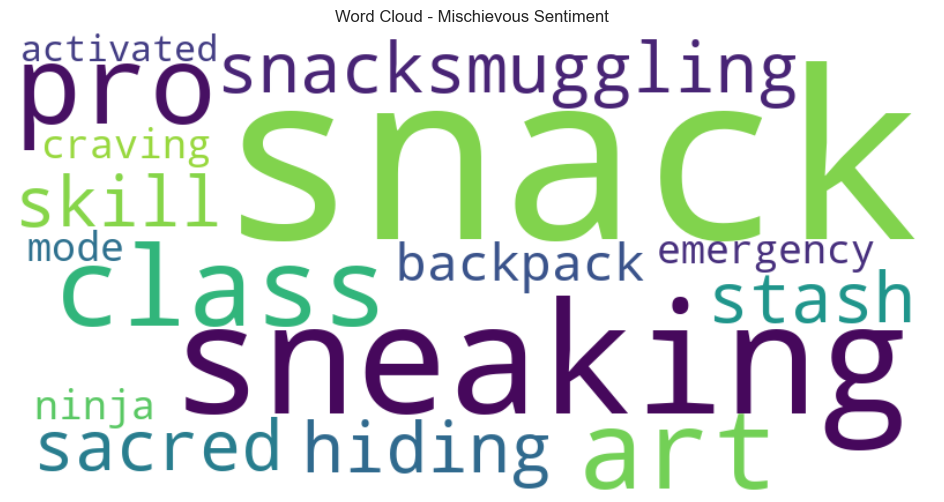

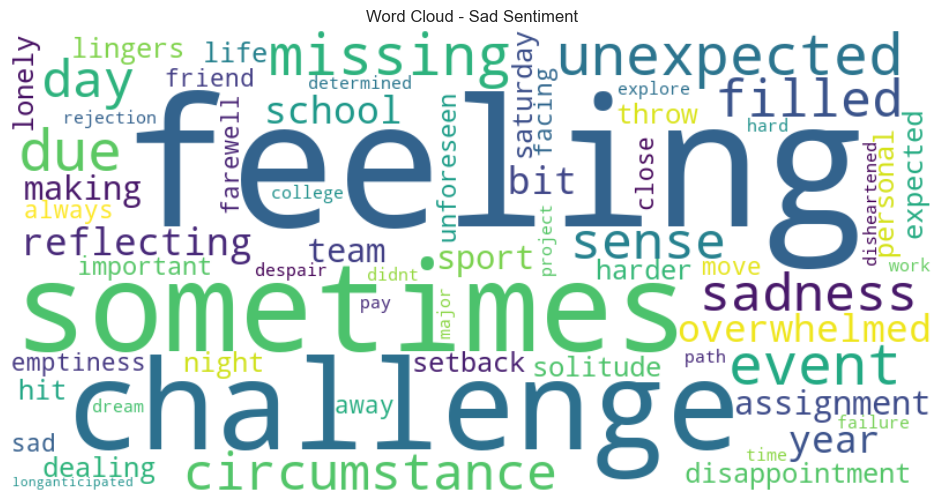

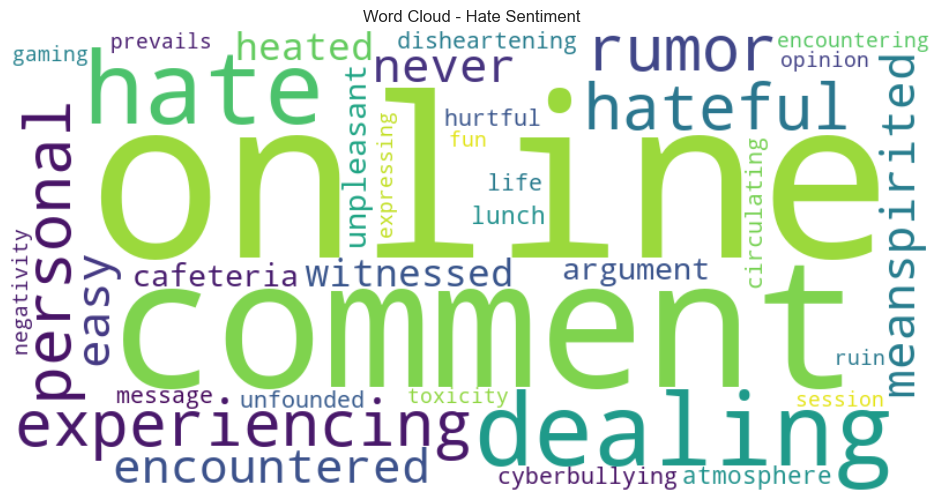

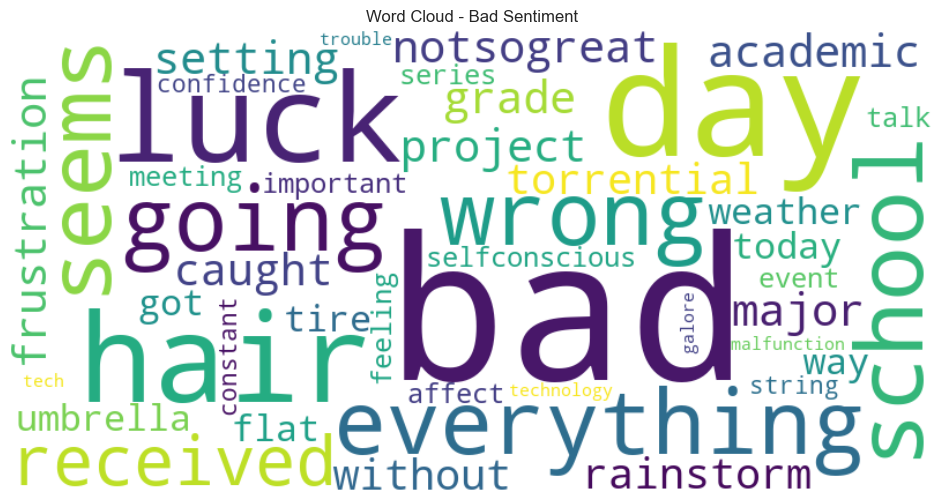

In [25]:
# 4. Exploratory Data Analysis (EDA)

print("\nStep 4: EDA...")

# Sentiment distribution
plt.figure()
sns.countplot(data=df, x='Sentiment', order=df['Sentiment'].value_counts().index, palette='viridis')
plt.title('Sentiment Distribution')
plt.xlabel('Sentiment')
plt.ylabel('Count')
plt.show()

# Word clouds for each sentiment
for sent in df['Sentiment'].unique():
    text = ' '.join(df[df['Sentiment'] == sent]['processed_text'])
    if text.strip():
        wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis').generate(text)
        plt.figure()
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'Word Cloud - {sent} Sentiment')
        plt.show()


In [26]:
# 5. Feature Extraction
# ========================
print("\nStep 5: Feature extraction...")

# 5.1 TF-IDF (Best for traditional classification)
tfidf_vectorizer = TfidfVectorizer(max_features=5000, ngram_range=(1,2))
X_tfidf = tfidf_vectorizer.fit_transform(df['processed_text'])

# 5.2 Word2Vec (Average embedding - alternative)
print("Training Word2Vec model...")
sentences = [text.split() for text in df['processed_text']]
w2v_model = Word2Vec(sentences, vector_size=100, window=5, min_count=2, workers=4)

def get_w2v_embedding(text):
    words = text.split()
    vectors = [w2v_model.wv[word] for word in words if word in w2v_model.wv]
    return np.mean(vectors, axis=0) if vectors else np.zeros(100)

X_w2v = np.array([get_w2v_embedding(text) for text in df['processed_text']])

y = df['Sentiment']


Step 5: Feature extraction...
Training Word2Vec model...


Sentiment counts (before filtering):
Sentiment
Positive                59
Joy                     44
Excitement              37
Contentment             19
Neutral                 18
                        ..
Nature's Beauty          1
Thrilling Journey        1
Relief                   1
Ocean's Freedom          1
Whispers of the Past     1
Name: count, Length: 190, dtype: int64

Rows after filtering rare classes: 458
Remaining sentiments: ['Acceptance', 'Ambivalence', 'Awe', 'Bad', 'Betrayal', 'Bitterness', 'Confusion', 'Contentment', 'Curiosity', 'Despair', 'Determination', 'Disgust', 'Elation', 'Embarrassed', 'Empowerment', 'Enthusiasm', 'Euphoria', 'Excitement', 'Frustrated', 'Frustration', 'Gratitude', 'Grief', 'Happiness', 'Hate', 'Hope', 'Hopeful', 'Indifference', 'Inspiration', 'Inspired', 'Joy', 'Loneliness', 'Melancholy', 'Neutral', 'Nostalgia', 'Numbness', 'Playful', 'Positive', 'Pride', 'Regret', 'Sad', 'Serenity', 'Surprise']
TF-IDF features created: (458, 4308)
Train sam

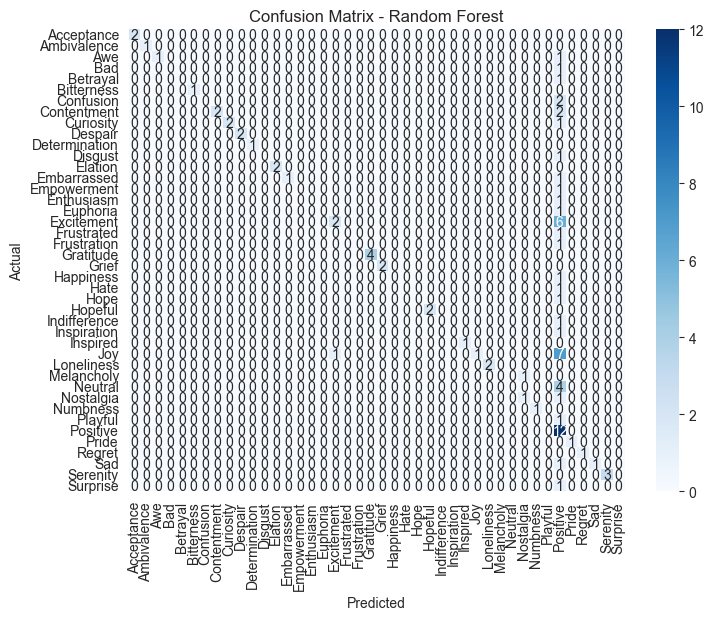

In [27]:
# 6. Train-Test Split
# ========================
# Count sentiment frequencies
sentiment_counts = df['Sentiment'].value_counts()
print("Sentiment counts (before filtering):")
print(sentiment_counts)

# Keep only sentiments with at least 5 samples (safe threshold)
min_samples = 5
valid_sentiments = sentiment_counts[sentiment_counts >= min_samples].index
df_filtered = df[df['Sentiment'].isin(valid_sentiments)].copy()
df_filtered = df_filtered.reset_index(drop=True)

print(f"\nRows after filtering rare classes: {len(df_filtered)}")
print("Remaining sentiments:", sorted(df_filtered['Sentiment'].unique()))

# Final empty text removal (double safety)
df_filtered = df_filtered[df_filtered['processed_text'].str.strip() != '']
df_filtered = df_filtered.reset_index(drop=True)

# TF-IDF Vectorization
vectorizer = TfidfVectorizer(max_features=5000, ngram_range=(1,2))
X = vectorizer.fit_transform(df_filtered['processed_text'])
y = df_filtered['Sentiment']

print("TF-IDF features created:", X.shape)

# Train-test split (NOW SAFE — all classes have >=5 samples)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

print(f"Train samples: {X_train.shape[0]}")
print(f"Test samples: {X_test.shape[0]}")

# Models
models = {
    'Logistic Regression': LogisticRegression(max_iter=1000),
    'Naive Bayes': MultinomialNB(),
    'Random Forest': RandomForestClassifier(n_estimators=100, random_state=42)
}

results = {}

print("\nTraining models...")
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    
    acc = accuracy_score(y_test, y_pred)
    results[name] = acc
    
    print(f"\n{name} Accuracy: {acc:.4f}")
    print(classification_report(y_test, y_pred, zero_division=0))

# Best model
best_model_name = max(results, key=results.get)
print(f"\nBest model: {best_model_name} (Accuracy: {results[best_model_name]:.4f})")

# Confusion Matrix
best_model = models[best_model_name]
y_pred_best = best_model.predict(X_test)

labels = sorted(y.unique())
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_test, y_pred_best, labels=labels)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=labels, yticklabels=labels)
plt.title(f'Confusion Matrix - {best_model_name}')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()



No results — using Logistic Regression as default
Generating confusion matrix for best model: Logistic Regression


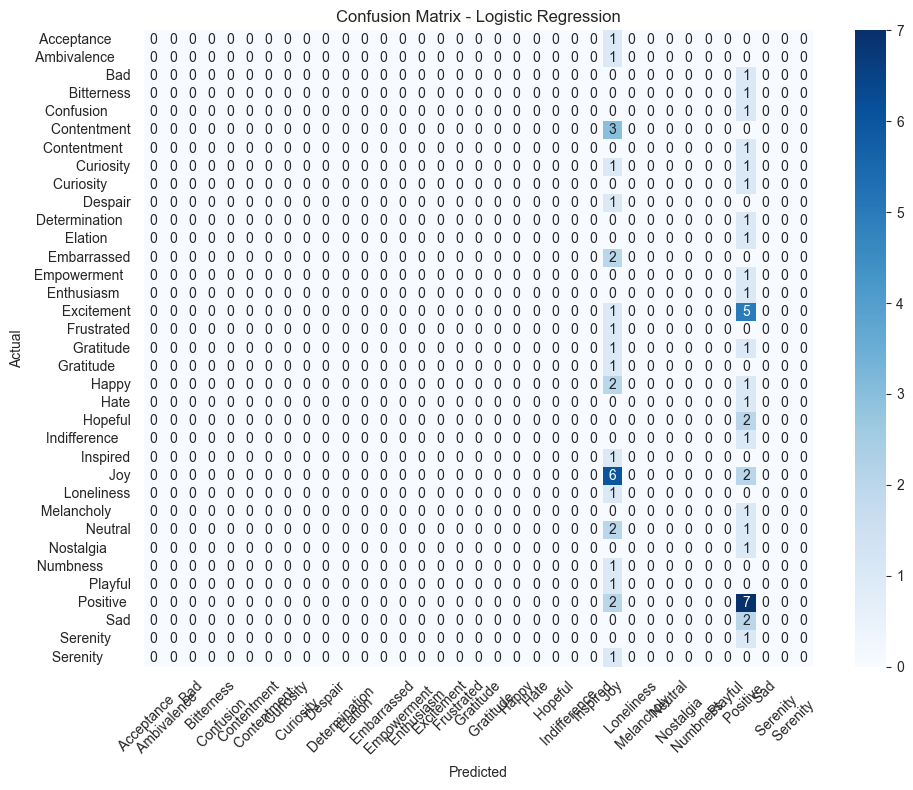


Project Complete!
- Dataset cleaned and explored
- Text preprocessed with lemmatization and stop words removal
- Rare classes filtered for stable modeling
- TF-IDF features + 3 models trained
- Best model: Logistic Regression
- Visualizations show sentiment patterns and model performance


In [41]:
# 6. Confusion Matrix for Best Model (Fixed - No NameError)
# Ensures best_model_name is defined safely
# ========================

# Safely get best model name (fallback to Logistic if empty)
if 'results' not in locals() or not results:
    print("No results — using Logistic Regression as default")
    best_model_name = 'Logistic Regression'
else:
    best_model_name = max(results, key=results.get)

print(f"Generating confusion matrix for best model: {best_model_name}")

# Get the best model
best_model = models[best_model_name]
y_pred_best = best_model.predict(X_test)

# Get current labels (safe)
labels = sorted(y.unique())

plt.figure(figsize=(10, 8))
cm = confusion_matrix(y_test, y_pred_best, labels=labels)

sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=labels, yticklabels=labels)
plt.title(f'Confusion Matrix - {best_model_name}')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

print("\nProject Complete!")
print("- Dataset cleaned and explored")
print("- Text preprocessed with lemmatization and stop words removal")
print("- Rare classes filtered for stable modeling")
print("- TF-IDF features + 3 models trained")
print(f"- Best model: {best_model_name}")
print("- Visualizations show sentiment patterns and model performance")